# Analyse du boxing via tesseract


In [ ]:
#Import Utiles
import pandas as pd
import numpy as np
from collections import Counter
from PIL import Image
import seaborn as sns
import PIL.Image
from tqdm.notebook import tqdm

%pylab inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from matplotlib import cm # Pour importer de nouvelles cartes de couleur
%matplotlib inline

import pytesseract
from pytesseract import Output


import itertools # Pour créer des iterateurs

In [2]:
# import des dataframes forms et words
df = pd.read_csv('forms.csv')
dfword = pd.read_csv('word.csv')
df.head()

,form id,writer id,number of sentences,word segmentation,NBTO,NBOK,WOTO,WOOK,path
0,a01-000u,0,2,prt,7,5,52,36,forms/a01-000u.png
1,a01-000x,1,2,all,6,6,52,52,forms/a01-000x.png
2,a01-003,2,3,prt,11,10,81,71,forms/a01-003.png
3,a01-003u,0,3,prt,11,10,80,73,forms/a01-003u.png
4,a01-003x,3,3,prt,9,6,82,56,forms/a01-003x.png


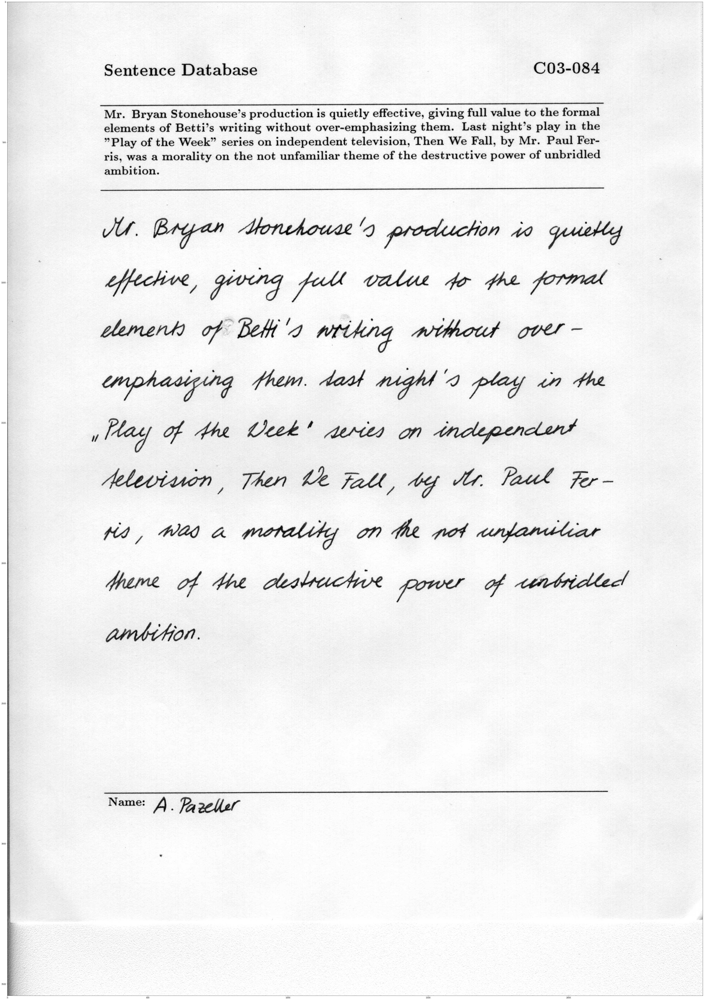

In [13]:
#Sélection d'un formulaire aléatoire
dfsample=df.sample(n=2)
dfsample=dfsample.reset_index(drop=True)

#Sélection des lignes du formulaire dans le dfword
dfwordsample = dfword[dfword['fileName'].str.contains(dfsample.loc[0,'form id'])]
dfwordsample=dfwordsample.reset_index(drop=True)

# Chargement de l'image ,création d'une copy pour affichage finale, convertion en nuance de gris 
img = cv2.imread(dfsample.loc[0,'path'])
img_clone = img.copy() # création d'une copy du formulaire 
image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


#Affichage du formulaire
plt.figure(figsize=(100,100))
plt.imshow(image,cmap='gray')


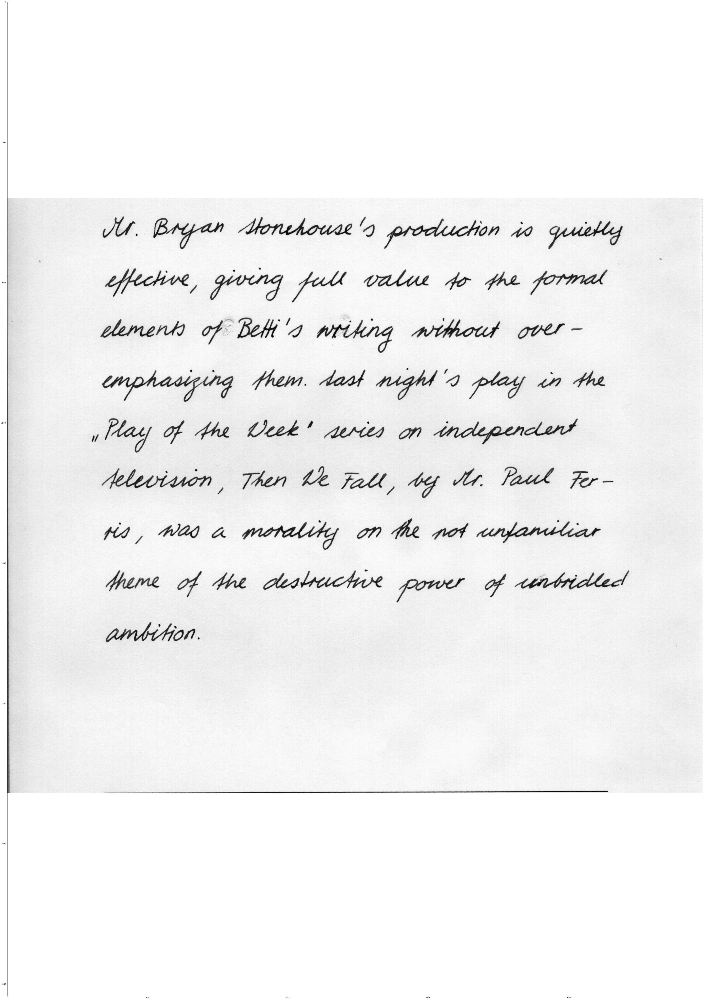

In [14]:
# Preprocess de l'image pour ne garder que le texte manuscrit de l'image 

for i in range(700):
    for j in range(2479):
        image[i,j] = 255
        
for i in range(2820,3542):
    for j in range(2479):
        image[i,j] = 255

# Affichage du résultat
plt.figure(figsize=(100,100))
plt.imshow(image,cmap='gray')


### Utilisation de tesseract

In [15]:
# Utilisation de Tesseract avec un dataframe comme output

d = pytesseract.image_to_data(image, output_type='data.frame')

# Selection des lignes correspondants au boxing des mots du texte + reset index
d = d[(d['level'] == 5)]
d=d.reset_index()

# Boucle sur chaque ligne de notre dataframe tesseract pour traiter chaque box
n_boxes = len(d['level'])
for i in range(n_boxes):
    # définition des coordonnées de chaque box
    (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
    # Création d'un rectangle vert sur l'image original
    cv2.rectangle(img, (x, y), (x + w, y + h), (5, 25,5), 2)



In [16]:
# Boucle sur chaque ligne de notre dataframe dfword pour traiter chaque box de notre dataset initial

n_boxes2 = len(dfwordsample['fileName'])    
for i in range(n_boxes2):
    # définition des coordonnées de chaque box
    (x, y, w, h) = (dfwordsample['x_Begin'][i], dfwordsample['y_Begin'][i], dfwordsample['width'][i], dfwordsample['height'][i])
    # Création d'un rectangle vert sur l'image original
    cv2.rectangle(img_clone, (x, y), (x + w, y + h), (0, 255, 0), 2)

### Calcul de l'intersection over union

In [17]:
# IoU calculation
intersection = numpy.logical_and(img, img_clone)
union = numpy.logical_or(img, img_clone)
iou_score = numpy.sum(intersection) / numpy.sum(union)
print(iou_score)

0.9923872480653791


    Ce score peut nous servir de base pour nous aider à évaluer les effets de traitement de l'image sur le résultat de tesseract

### Affichage des différences entre les 2 images

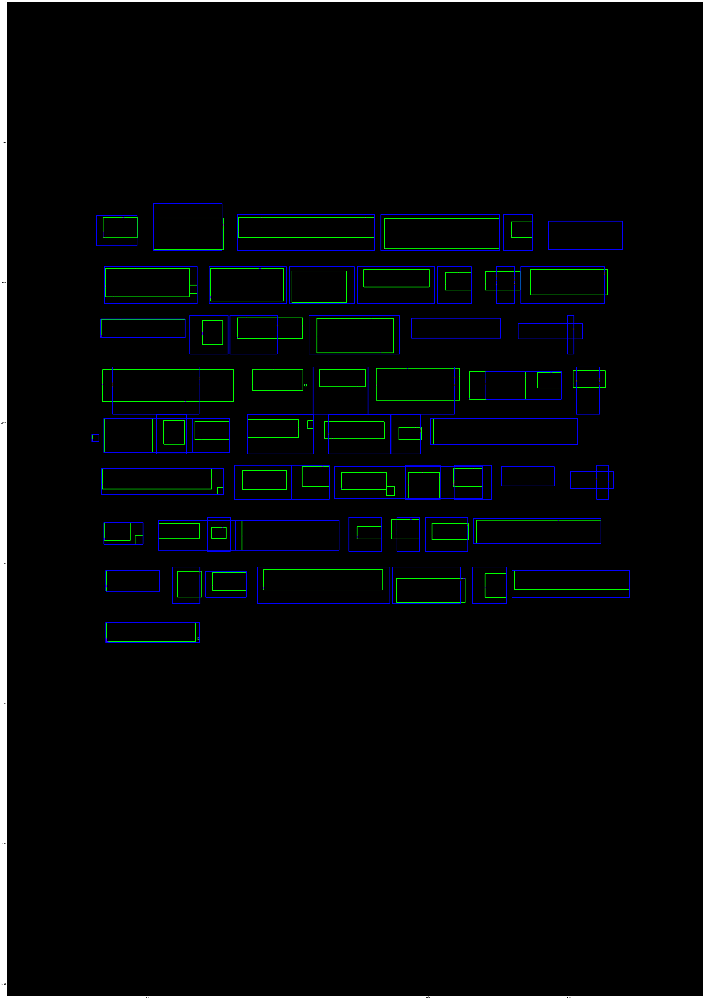

In [21]:


# compute difference calcul de la différence entre les différents boxing
difference = cv2.subtract(img_clone, img)
difference2 = cv2.subtract(img, img_clone)

# color the mask red
Conv_hsv_Gray = cv2.cvtColor(difference, cv2.COLOR_BGR2GRAY)
ret, mask = cv2.threshold(Conv_hsv_Gray, 0, 255,cv2.THRESH_BINARY_INV |cv2.THRESH_OTSU)
difference[mask != 255] = [0, 0, 255]

Conv_hsv_Gray = cv2.cvtColor(difference2, cv2.COLOR_BGR2GRAY)
ret, mask = cv2.threshold(Conv_hsv_Gray, 0, 255,cv2.THRESH_BINARY_INV |cv2.THRESH_OTSU)
difference2[mask != 255] = [0, 255, 0]

somme = cv2.add(difference,difference2)


plt.figure(figsize=(100,100))
plt.imshow(somme)